In [1]:
# !pip install diffusers transformers torch Pillow

In [2]:
import torch
from diffusers import StableDiffusionXLPipeline, UNet2DConditionModel
from transformers import AutoProcessor, AutoModel
from PIL import Image

torch.set_grad_enabled(False)

selector_processor_name_or_path = "laion/CLIP-ViT-H-14-laion2B-s32B-b79K"
selector_model_pretrained_name_or_path = "yuvalkirstain/PickScore_v1"

pretrained_model_name = "stabilityai/stable-diffusion-xl-base-1.0"
gs = 7.5

In [3]:
class Selector():
    # from https://github.com/SalesforceAIResearch/DiffusionDPO/blob/main/utils/pickscore_utils.py

    def __init__(self, device):
        self.device = device
        self.processor = AutoProcessor.from_pretrained(selector_processor_name_or_path)
        self.model = AutoModel.from_pretrained(selector_model_pretrained_name_or_path).eval().to(device)

    def score(self, images, prompt, softmax=False):

        # preprocess
        image_inputs = self.processor(
            images=images,
            padding=True,
            truncation=True,
            max_length=77,
            return_tensors="pt",
        ).to(self.device)

        text_inputs = self.processor(
            text=prompt,
            padding=True,
            truncation=True,
            max_length=77,
            return_tensors="pt",
        ).to(self.device)


        with torch.no_grad():
            # embed
            image_embs = self.model.get_image_features(**image_inputs)
            image_embs = image_embs / torch.norm(image_embs, dim=-1, keepdim=True)

            text_embs = self.model.get_text_features(**text_inputs)
            text_embs = text_embs / torch.norm(text_embs, dim=-1, keepdim=True)

            # score
            scores =  (text_embs @ image_embs.T)[0]

            if softmax:
                scores = self.model.logit_scale.exp() * scores
                # get probabilities if you have multiple images to choose from
                probs = torch.softmax(scores, dim=-1)
                return probs.cpu().tolist()
            else:
                return scores.cpu().tolist()


In [4]:
# Load the DPO UNet
dpo_unet = UNet2DConditionModel.from_pretrained(
    'mhdang/dpo-sdxl-text2image-v1',
    subfolder='unet',
    torch_dtype=torch.float16,
).to('cuda')

# Load SDXL pipeline
pipe = StableDiffusionXLPipeline.from_pretrained(
    pretrained_model_name,
    variant="fp16",
    torch_dtype=torch.float16,
    use_safetensors=True
).to('cuda')
pipe.safety_checker = None

# Score generations automatically w/ reward model
ps_selector = Selector('cuda')

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [5]:
unets = [pipe.unet, dpo_unet]
names = ["Orig. SDXL", "DPO SDXL"]

def gen(prompt, seed=0, run_baseline=True):
    ims = []
    generator = torch.Generator(device='cuda')
    for unet_i in ([0, 1] if run_baseline else [1]):
        print(f"Prompt: {prompt}\nSeed: {seed}\n{names[unet_i]}")
        pipe.unet = unets[unet_i]
        generator = generator.manual_seed(seed)

        # SDXL pipeline already handles the text embeddings correctly
        im = pipe(prompt=prompt, generator=generator, guidance_scale=gs).images[0]
        display(im)
        ims.append(im)
    return ims



Prompt: A redwood tree rising up out of the ocean
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

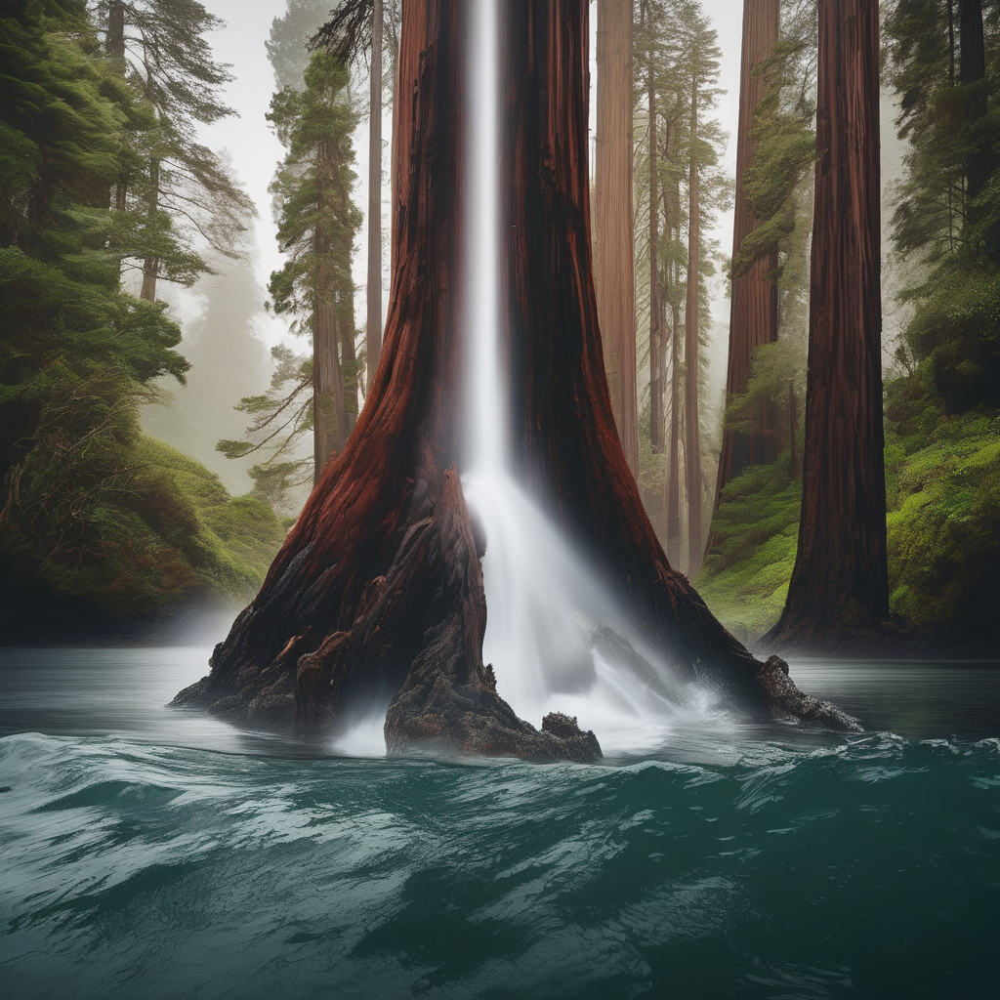

Prompt: A redwood tree rising up out of the ocean
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

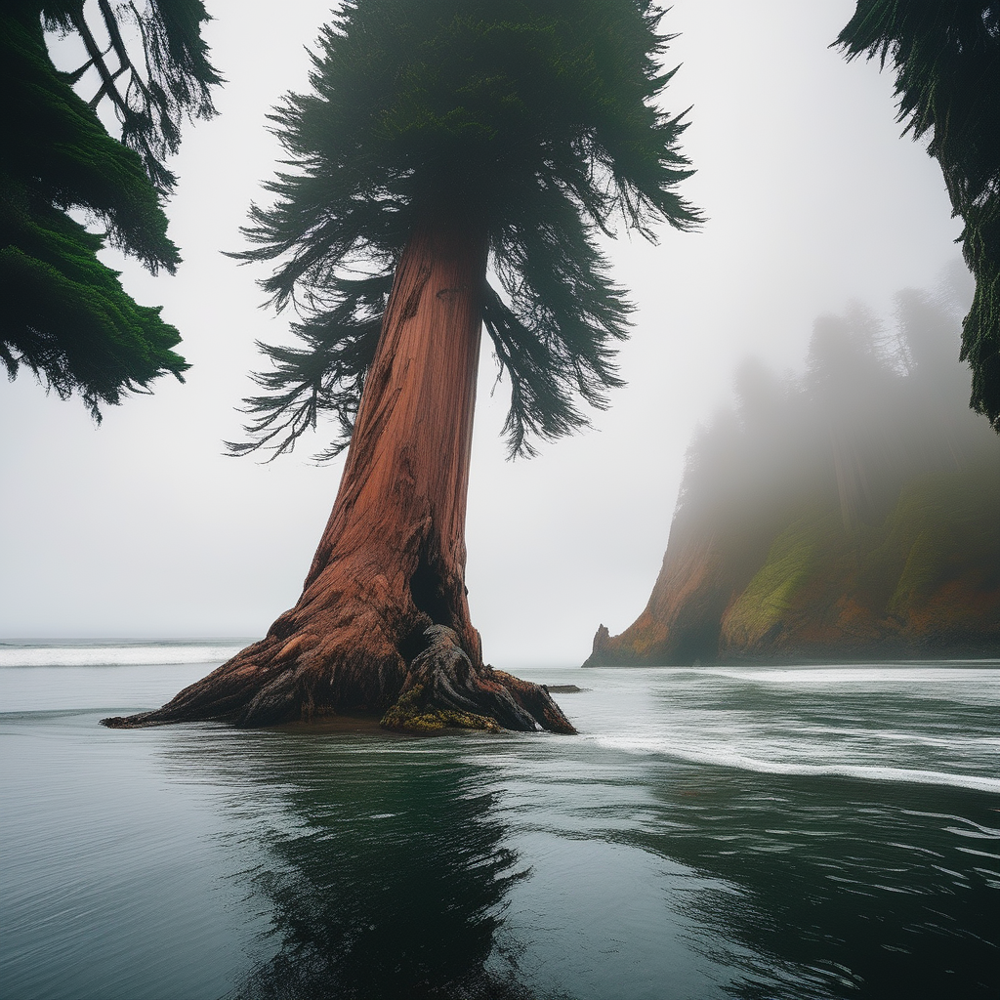

[0.2298296093940735, 0.23621909320354462]
Prompt: gigantic humming birds are attacking a medieval castle
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

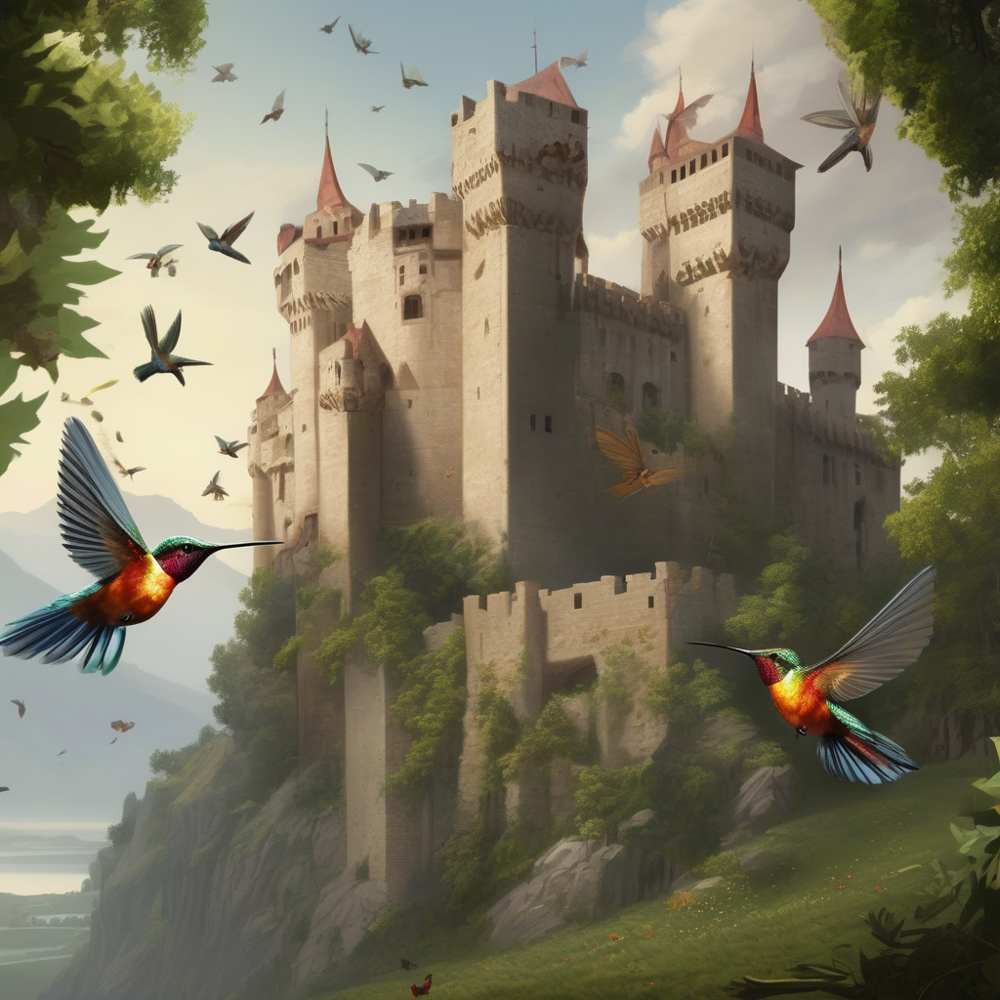

Prompt: gigantic humming birds are attacking a medieval castle
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

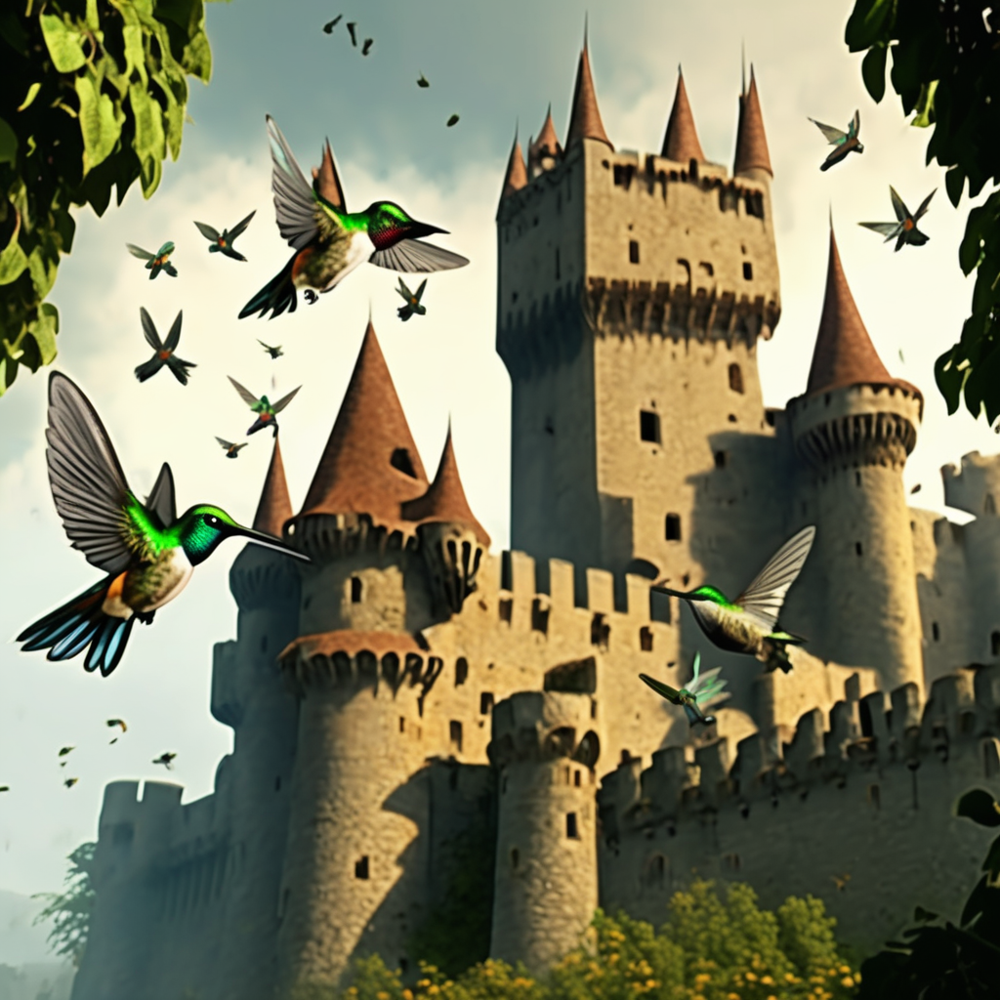

[0.23114366829395294, 0.22391262650489807]
Prompt: A typhoon in a tea cup, digital render
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

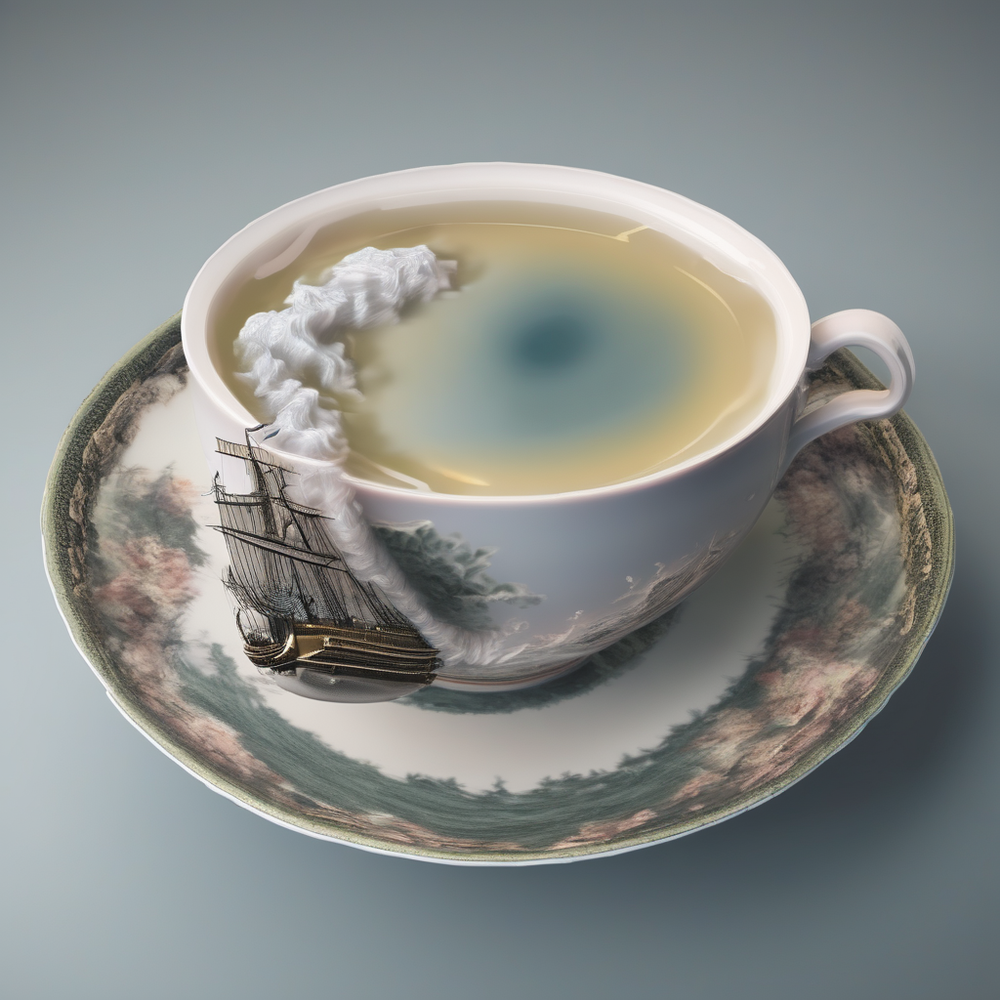

Prompt: A typhoon in a tea cup, digital render
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

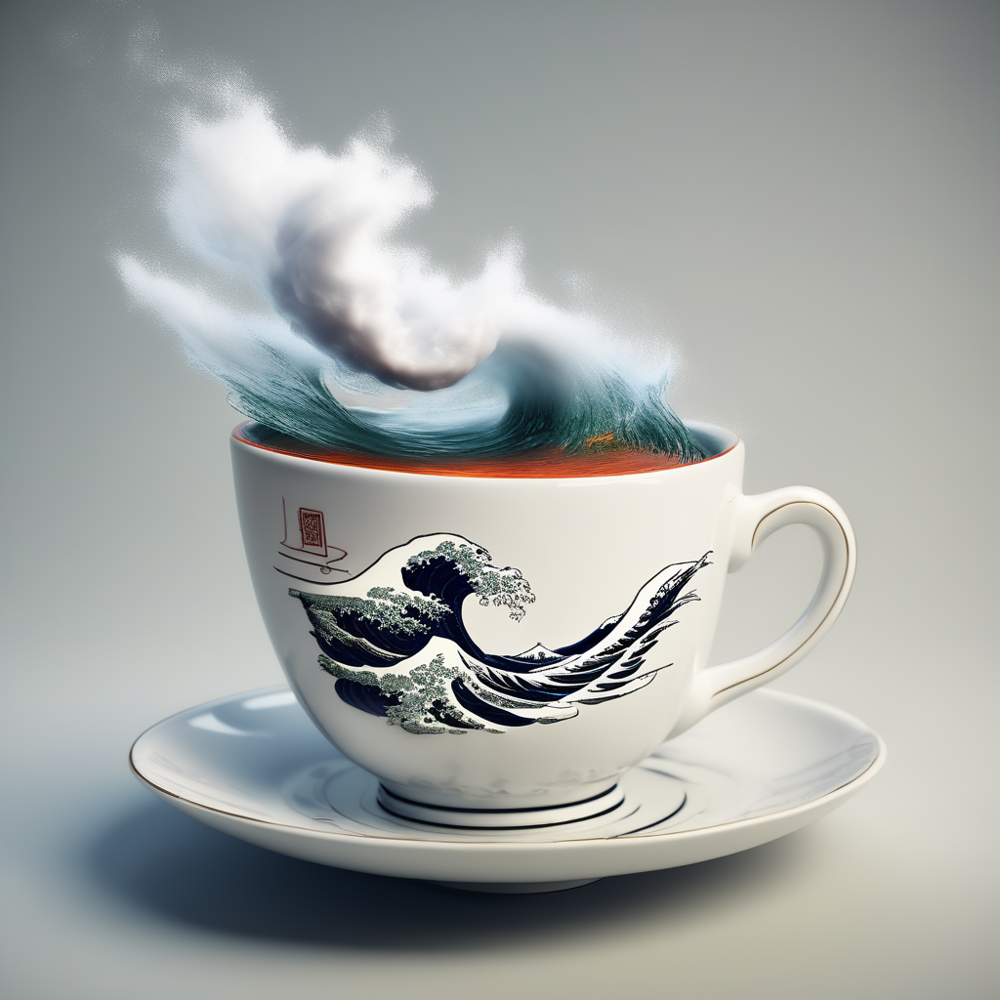

[0.2247866988182068, 0.22321602702140808]
Prompt: A cute puppy leading a session of the United Nations, newspaper photography
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

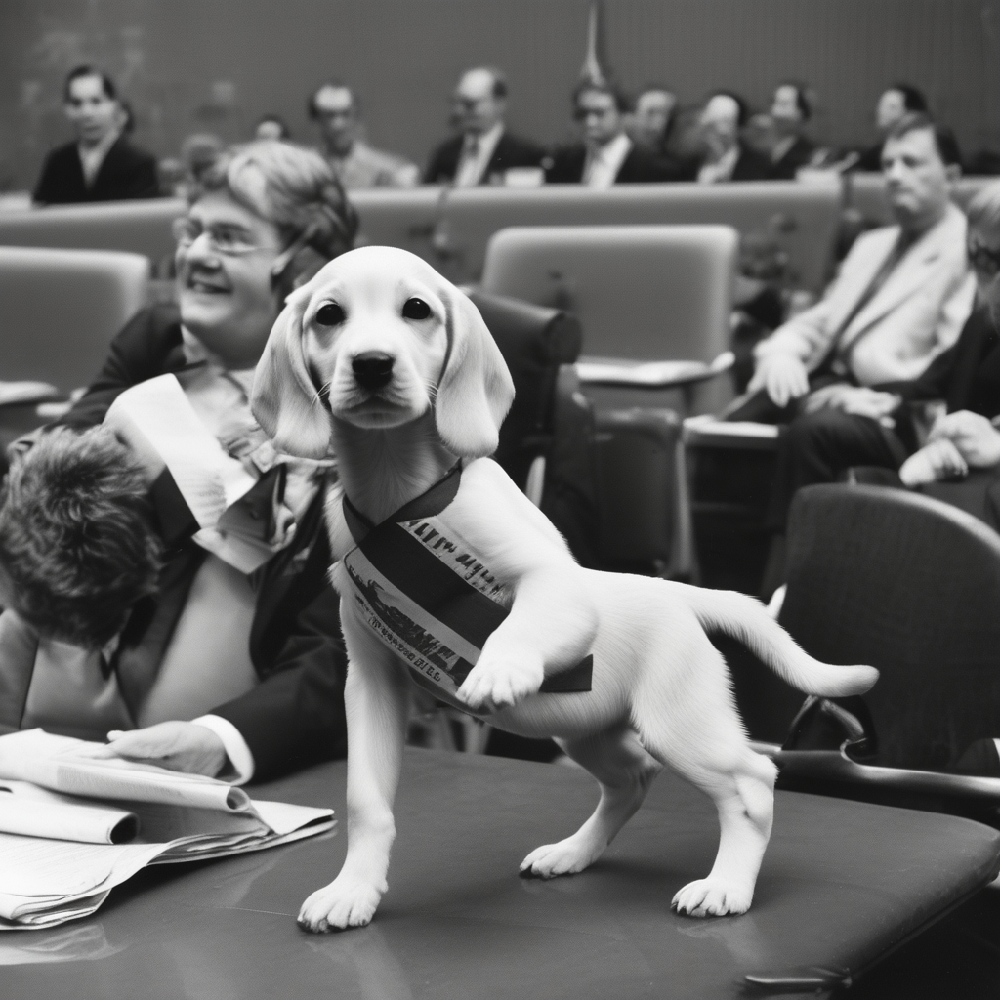

Prompt: A cute puppy leading a session of the United Nations, newspaper photography
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

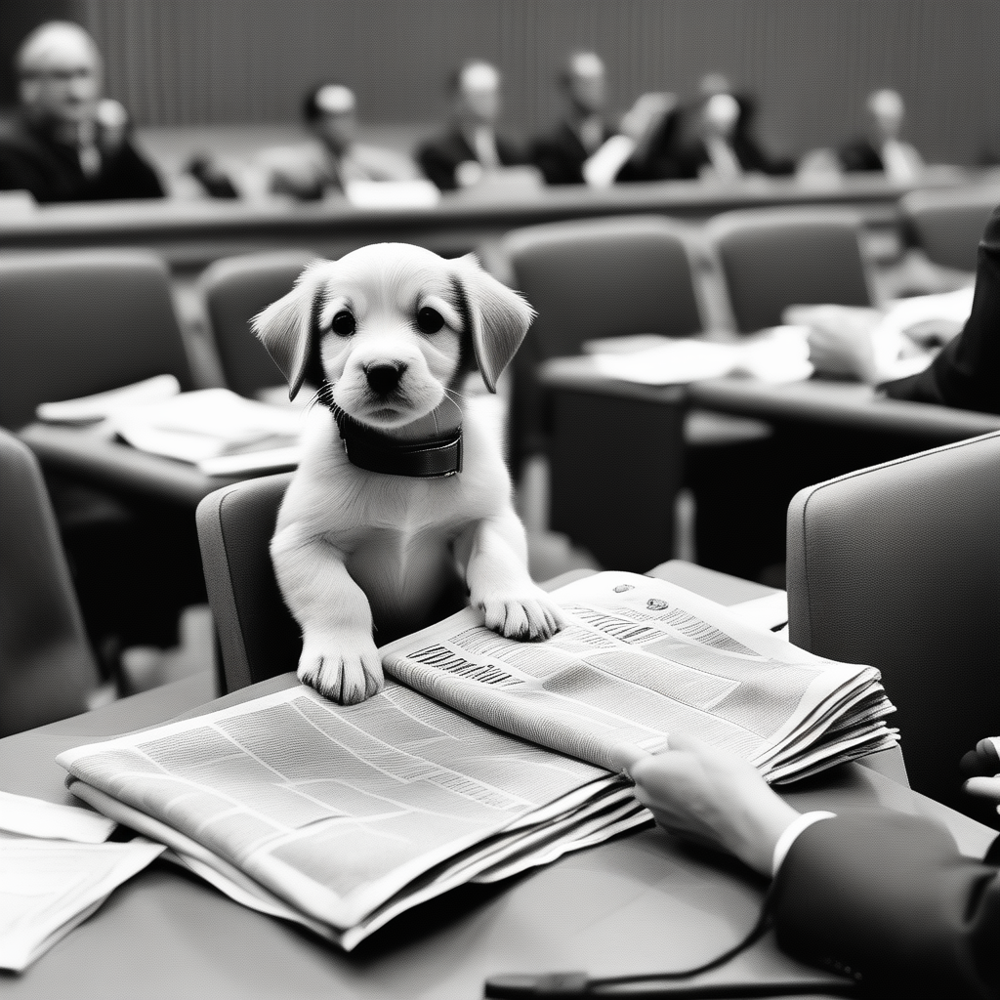

[0.20840302109718323, 0.22527135908603668]
Prompt: A baby kangaroo in a trenchcoat
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

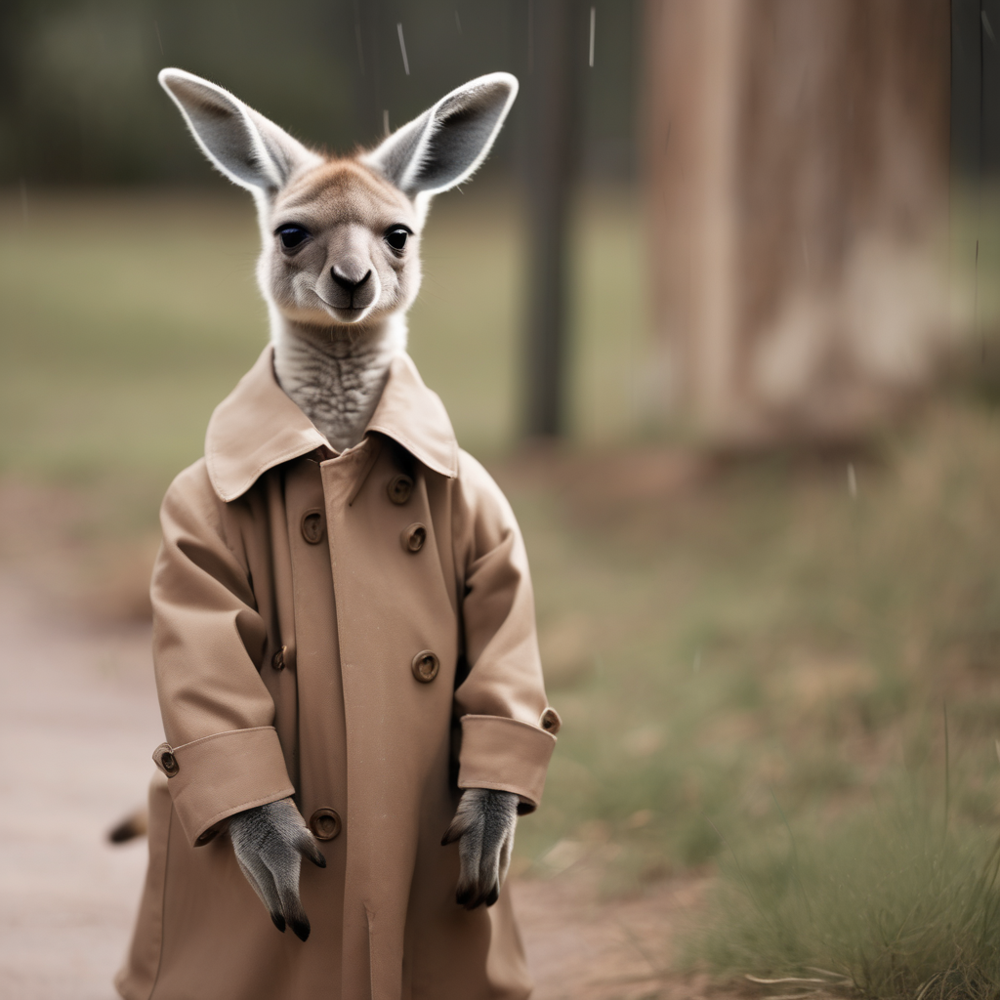

Prompt: A baby kangaroo in a trenchcoat
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

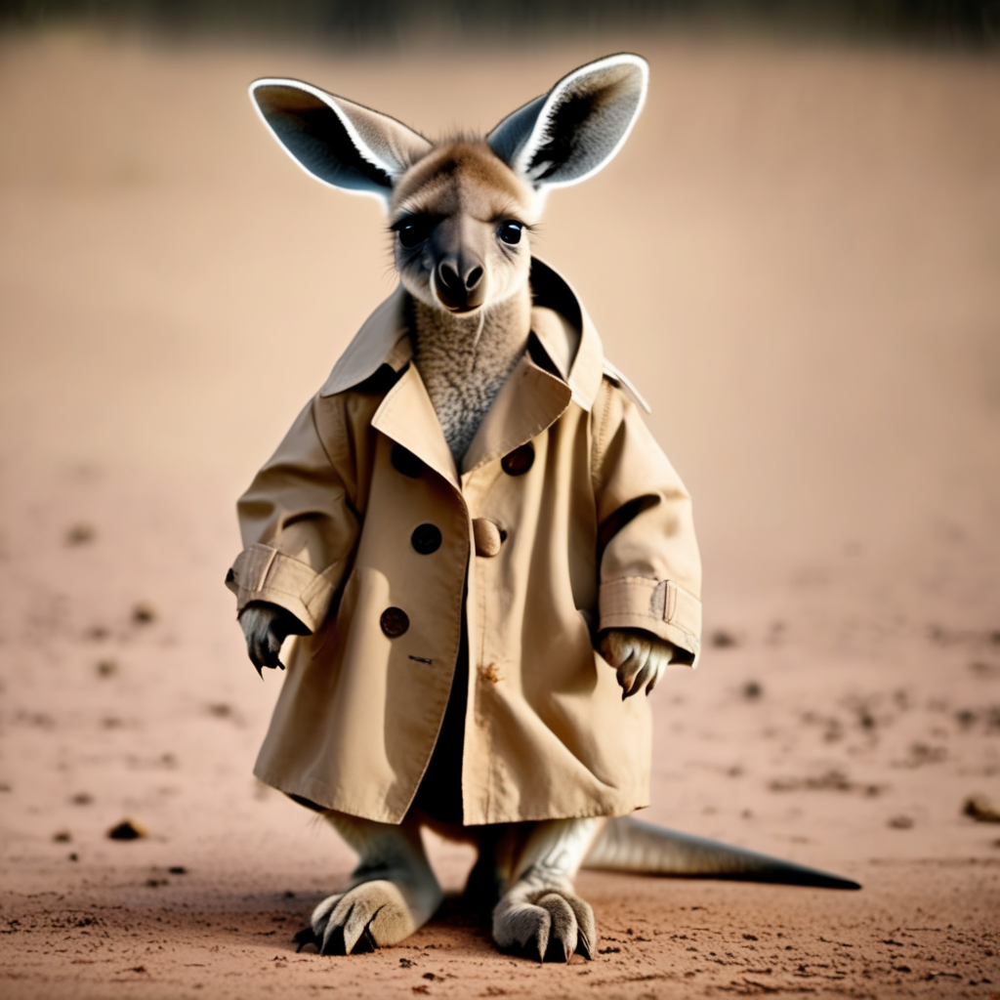

[0.22940872609615326, 0.22518010437488556]


In [6]:
example_prompts = ["A redwood tree rising up out of the ocean",
                   "gigantic humming birds are attacking a medieval castle",
                   "A typhoon in a tea cup, digital render",
                   "A cute puppy leading a session of the United Nations, newspaper photography",
                   "A baby kangaroo in a trenchcoat",
                   ]

for p in example_prompts:
    ims = gen(p)
    scores = ps_selector.score(ims, p)
    print(scores)